In [ ]:
!gdown https://drive.google.com/uc?id=1xO4rZpeKoFzRiY554P7ch_fsx5daYb_4&export=download
!unzip -q global-wheat-detection.zip

Downloading...
From: https://drive.google.com/uc?id=1xO4rZpeKoFzRiY554P7ch_fsx5daYb_4
To: /content/global-wheat-detection.zip
637MB [00:06, 96.0MB/s]


In [ ]:
import numpy as np
import pandas as pd
from glob import glob
import os
import cv2
from skimage import io
from google.colab.patches import cv2_imshow
from matplotlib.patches import Rectangle
import matplotlib.pyplot as plt
%matplotlib inline
from IPython import display

# we will import all required libraries for this tutorial in advance

import imgaug as ia
ia.seed(1)
# imgaug uses matplotlib backend for displaying images
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage
from imgaug import augmenters as iaa
# imageio library will be used for image input/output
import imageio
import re
# this library is needed to read XML files for converting it into CSV
import xml.etree.ElementTree as ET
import shutil

In [ ]:
train_data = pd.read_csv("train.csv")
train_images = "/content/train/"
test_images = "/content/test/"

In [ ]:
train_data.head()

,image_id,width,height,bbox,source
0,b6ab77fd7,1024,1024,"[834.0, 222.0, 56.0, 36.0]",usask_1
1,b6ab77fd7,1024,1024,"[226.0, 548.0, 130.0, 58.0]",usask_1
2,b6ab77fd7,1024,1024,"[377.0, 504.0, 74.0, 160.0]",usask_1
3,b6ab77fd7,1024,1024,"[834.0, 95.0, 109.0, 107.0]",usask_1
4,b6ab77fd7,1024,1024,"[26.0, 144.0, 124.0, 117.0]",usask_1


In [ ]:
train_list = glob(train_images + '*')
test_list = glob(test_images + '*')

now we test correspondance of images in the data set with the images on the csv file

In [ ]:
len(train_list)


3422

In [ ]:
train_data['image_id'].unique().size

3373

some photos are not include in the data, we check if that photos are the ones with not bboxes


In [ ]:
train_data['bbox'].isnull().values.any()

False

the images witout bboxes are not included in the list. the total number of images without wheat heads is


In [ ]:
len(train_list) - train_data['image_id'].unique().size


49

we check that all images are the same size


In [ ]:
train_data['height'].unique()

array([1024])

In [ ]:
train_data['width'].unique()

array([1024])

now we test the quality of the bboxes and correct it

we start converting the bbox colum into coodinates each coordinate in its own column

In [ ]:
bboxes = np.stack(train_data['bbox'].apply(lambda x: np.fromstring(x[1:-1], sep=',')))
for i, column in enumerate(['x_min', 'y_min', 'widthb', 'heightb']):
    train_data[column] = bboxes[:,i]

train_data["x_max"] = train_data.apply(lambda col: col.x_min + col.widthb, axis=1)
train_data["y_max"] = train_data.apply(lambda col: col.y_min + col.heightb, axis = 1)
train_data.drop(columns=['bbox'], inplace=True)

In [ ]:
train_data.head()

,image_id,width,height,source,x_min,y_min,widthb,heightb,x_max,y_max
0,b6ab77fd7,1024,1024,usask_1,834.0,222.0,56.0,36.0,890.0,258.0
1,b6ab77fd7,1024,1024,usask_1,226.0,548.0,130.0,58.0,356.0,606.0
2,b6ab77fd7,1024,1024,usask_1,377.0,504.0,74.0,160.0,451.0,664.0
3,b6ab77fd7,1024,1024,usask_1,834.0,95.0,109.0,107.0,943.0,202.0
4,b6ab77fd7,1024,1024,usask_1,26.0,144.0,124.0,117.0,150.0,261.0


sourse and size now is useless information


In [ ]:
train_data.drop(columns=["widthb","heightb"], inplace=True)
train_data["label"] = "head"
train_data["source"] =train_data["label"]

we correct any value smaller than zero and bigger than 1024

In [ ]:
train_data.loc[train_data['x_min']<=0,'x_min']=0
train_data.loc[train_data['x_max']>=1024,'x_max']=1024
train_data.loc[train_data['y_min']<=0,'y_min']=0
train_data.loc[train_data['y_max']>=1024,'y_max']=1024

now we explore the bbox area distribution and check the biggest and smallest.

In [ ]:
train_data["deltax"] =train_data['x_max']-train_data['x_min']
train_data["deltay"] =train_data['y_max']-train_data['y_min']
train_data["area"] =train_data['deltax']*train_data['deltay']
train_data.drop(columns=["deltax","deltay"], inplace=True)

In [ ]:
train_data.drop(columns="label",inplace=True)
train_data.rename(columns={"source": "label"},inplace=True)

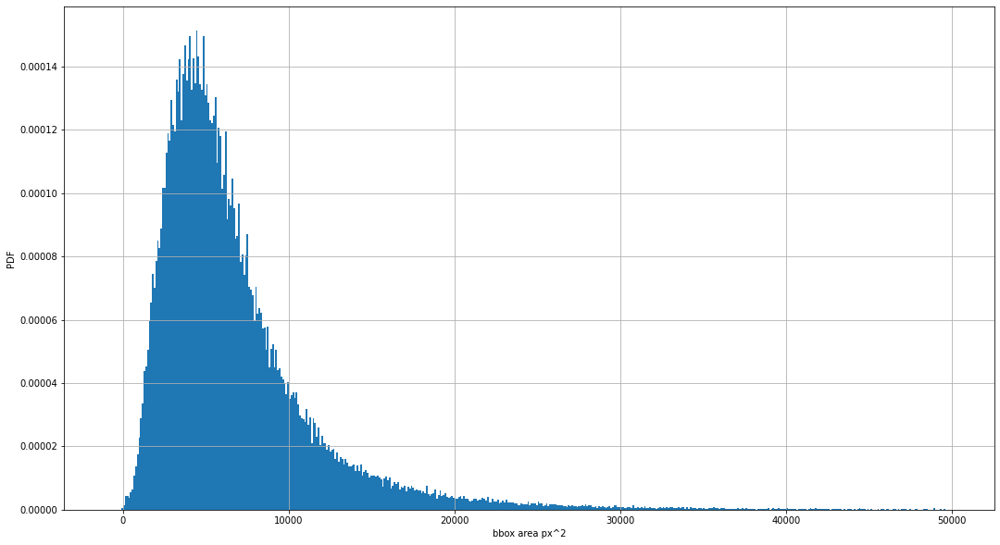

In [ ]:
fig = plt.gcf()
fig.set_size_inches(18, 10)
plt.hist(train_data['area'],density=True,bins=500,range=[-1000,50000])
plt.ylabel("PDF")
plt.xlabel("bbox area px^2")
plt.grid()
plt.show()

as we see there are some irregular bboxes
- some have a negative area
- some are too close to zero
- some have an area abnormaly large
we will analyze them and in case of being necesary eliminate them.

In [ ]:

def plot_boxes(img,list1):
    fig, axa = plt.subplots(figsize=(20,10))
    axa.imshow(img)

    ax = plt.gca()

    for i in range(0,len(list1)):
        rect = Rectangle((list1[i][0] ,list1[i][1]), list1[i][2] -list1[i][0],list1[i][3] -list1[i][1],linewidth=1,edgecolor='r',facecolor='none')
        ax.add_patch(rect)


In [ ]:
def bbox_check(image_folder_path, image_annotation_file, threshold, less_or_eq =True):
  #create a imageid-area directory to select images using a criterion
  img_select = dict(zip(image_annotation_file.image_id, image_annotation_file.area))
    # choose image.
 # image_annotation_file=image_annotation_file.drop(columns=["width","height","label"])
  img_files_list =list()
  if less_or_eq == True:
    for iid,area in img_select.items():
      if area <= threshold:
        img_files_list.append(iid)
    print("The images' names with area lower than ",str(threshold)," are {}".format(img_files_list))
  else:
    for iid,area in img_select.items():
      if area >= threshold:
        img_files_list.append(iid)
    print("The images' names with area higher than ",str(threshold)," are {}".format(img_files_list))

  for im in img_files_list:
      box_data=image_annotation_file[image_annotation_file['image_id']==im]
      image_file_path = os.path.join(image_folder_path, im)
      image_file_path +=".jpg"
      img = cv2.imread(image_file_path)[:,:,::-1]
      height, width, channels = img.shape
      box_data=box_data[['x_min','y_min','x_max','y_max']]
      list1=[]
      for i in list(box_data.index):
          rowData = box_data.loc[ i , : ]
          list1.append(list(rowData))
      plot_boxes(img,list1)


The images' names with area lower than  350  are ['7c9096e13', '35af6e100', '218a99bee', '0e0809a3d', '277fa7280']


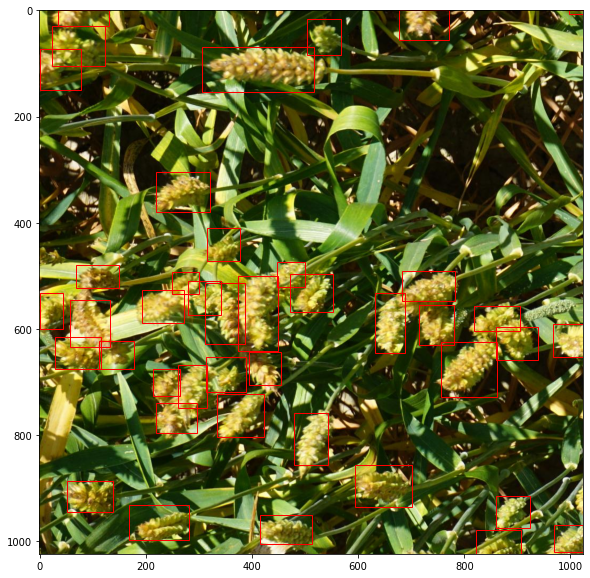

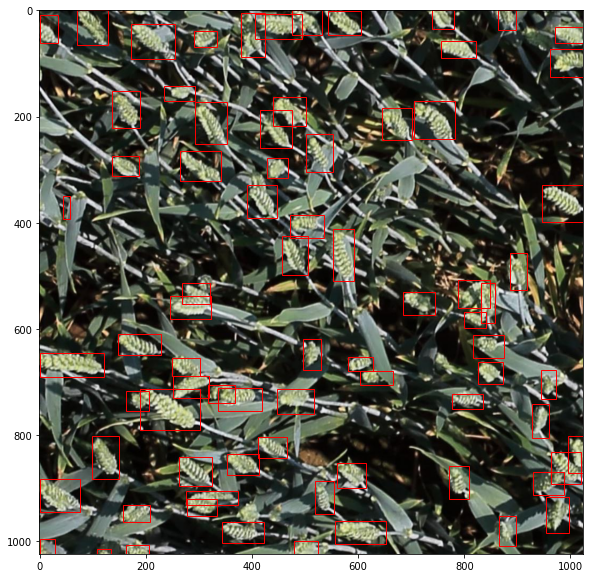

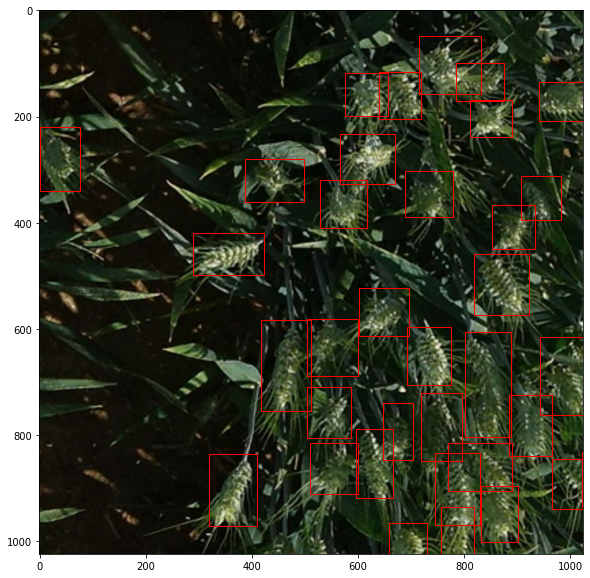

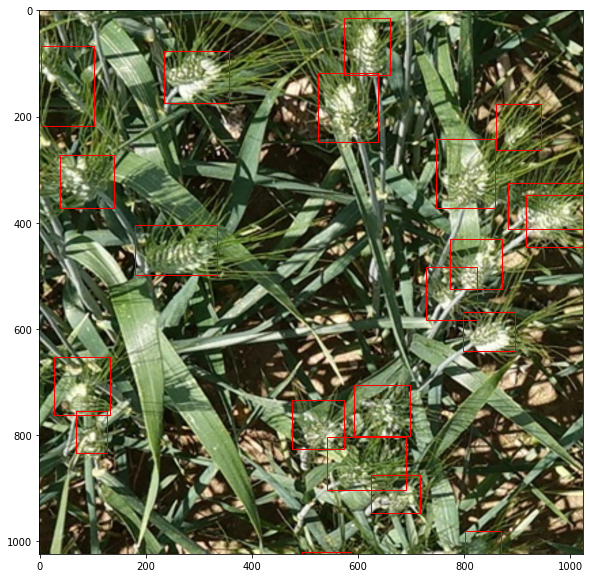

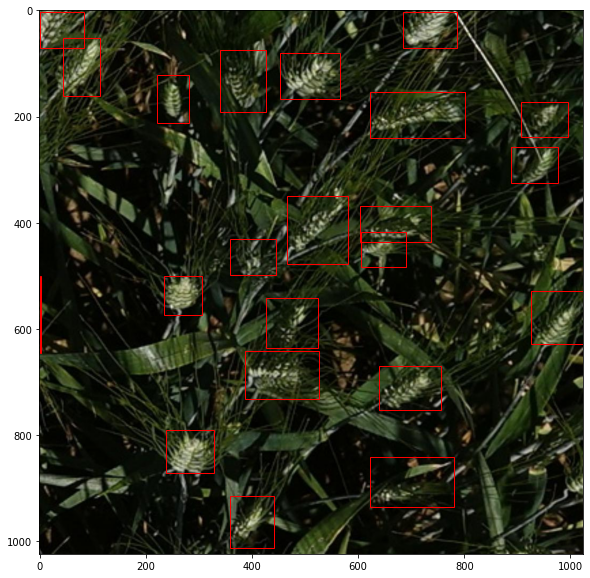

In [ ]:
bbox_check(train_images,train_data,350)

by visual exploration we can see that all the bboxes smaller than 350 are peaces of non recognisable wheat heads, so we delete them

In [ ]:
remove= train_data[train_data['area']<=350]#.area.unique()
train_filtred=train_data.drop(remove.index)

now we check for too big bboxes

The images' names with area higher than  30000  are ['68fedffd4', 'f1d20d58a', 'b7fc05af8', '91c9c8b5e', '14d856fb1', '3aaa6d134', 'e91b154aa', 'b824c0e55', 'ea3537563', '5c64b986e', '56f169f38', '409a8490c', 'd7a02151d', '5fb074443', 'd067ac2b1', '522edf5c3']


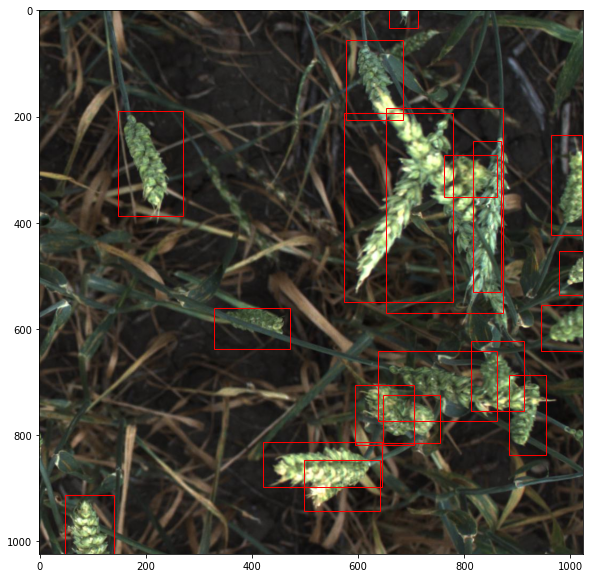

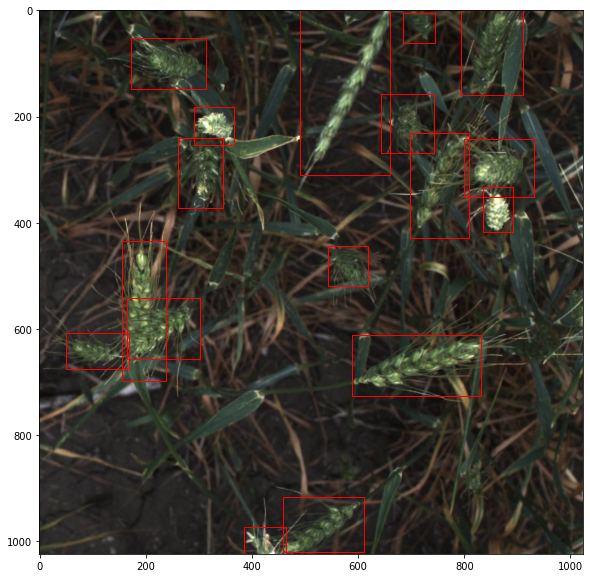

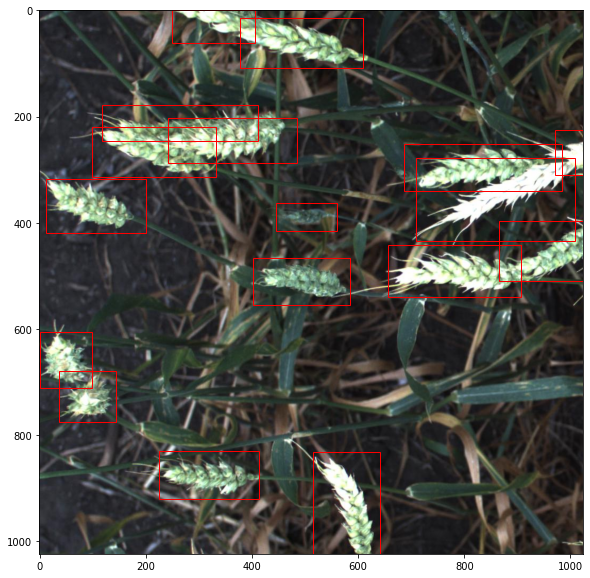

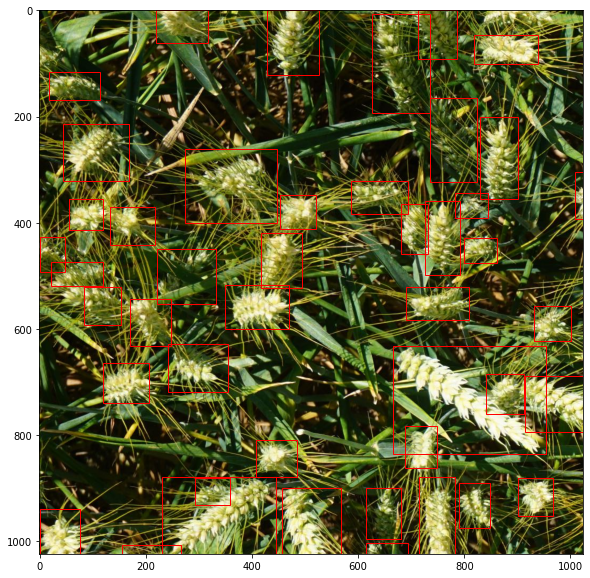

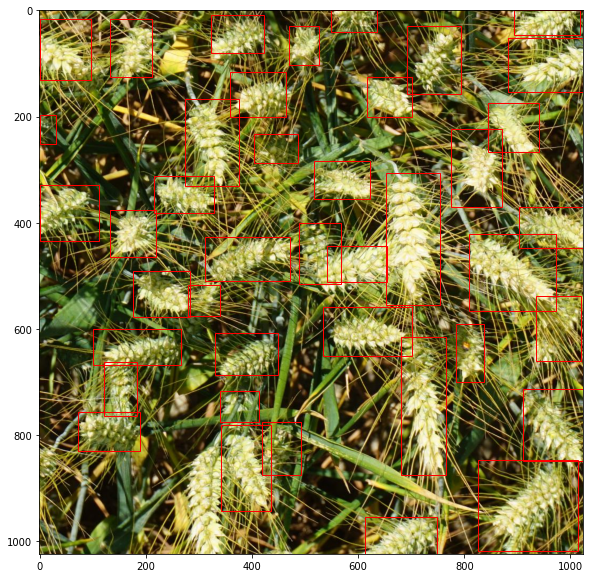

...

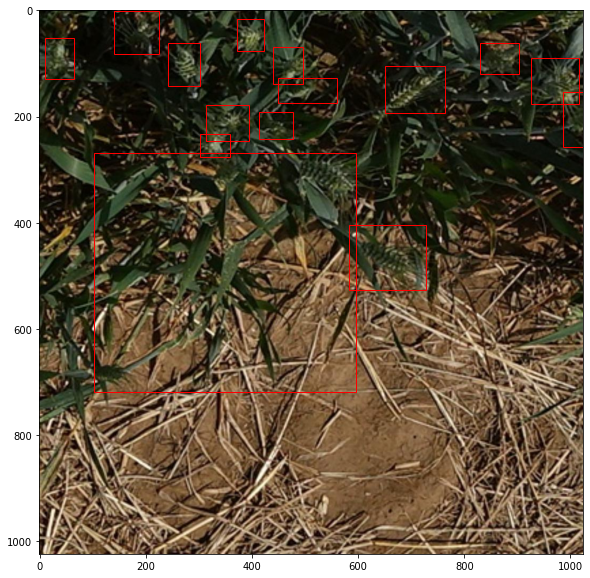

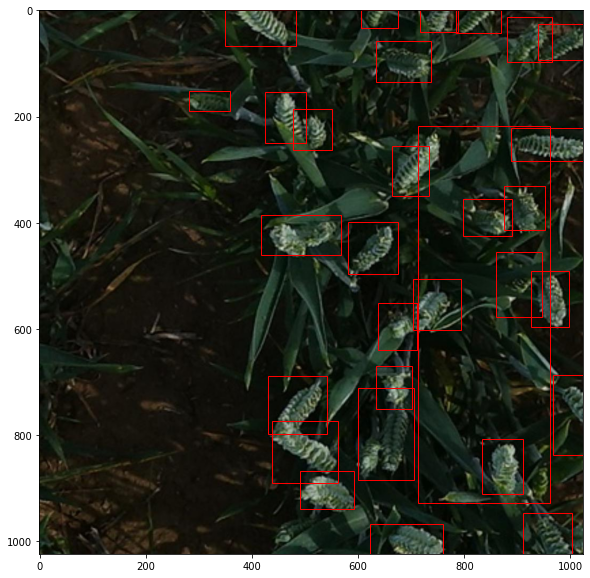

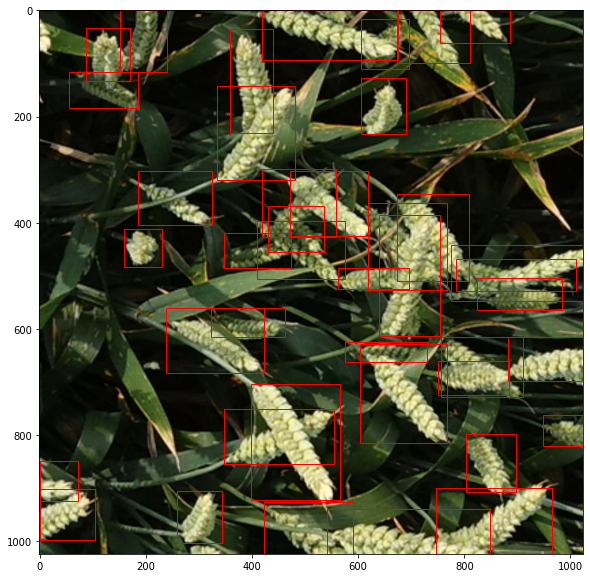

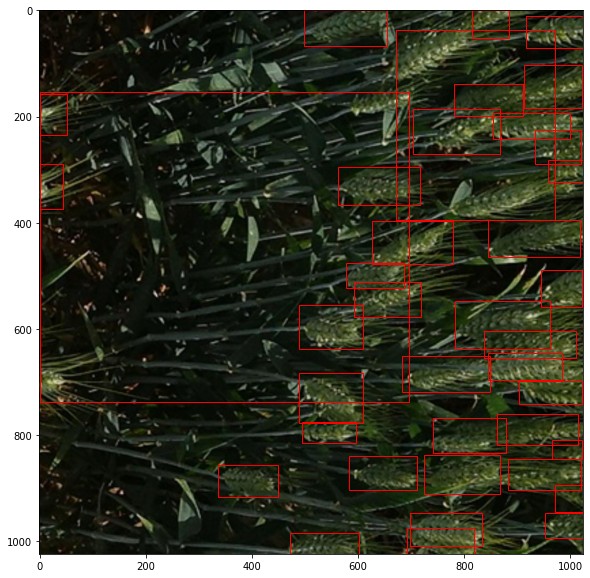

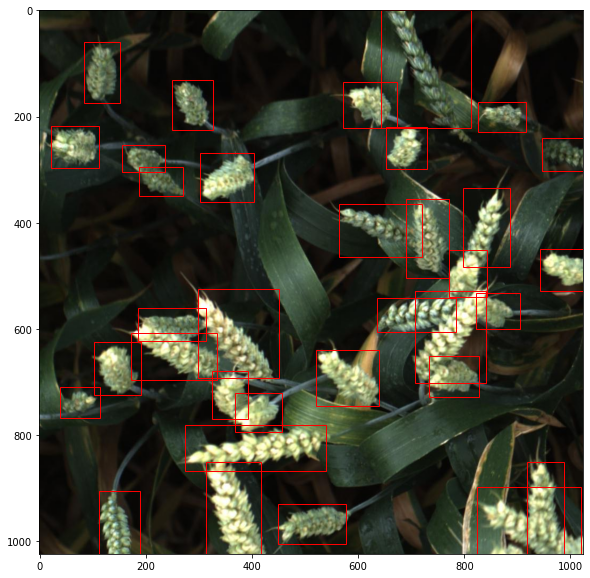

In [ ]:
bbox_check(train_images,train_data,30000,less_or_eq=False)

most of them are normal we try with filtering  bigger images

In [ ]:
bbox_check(train_images,train_data,850000,less_or_eq=False)

The images' names with area higher than  850000  are []


In [ ]:
remove= train_data[train_data['area']>=85000]
train_filtred=train_filtred.drop(remove.index)

In [ ]:
train_filtred

,image_id,width,height,label,x_min,y_min,x_max,y_max,area
0,b6ab77fd7,1024,1024,head,834.0,222.0,890.0,258.0,2016.0
1,b6ab77fd7,1024,1024,head,226.0,548.0,356.0,606.0,7540.0
2,b6ab77fd7,1024,1024,head,377.0,504.0,451.0,664.0,11840.0
3,b6ab77fd7,1024,1024,head,834.0,95.0,943.0,202.0,11663.0
4,b6ab77fd7,1024,1024,head,26.0,144.0,150.0,261.0,14508.0
...,...,...,...,...,...,...,...,...,...
147788,5e0747034,1024,1024,head,64.0,619.0,148.0,714.0,7980.0
147789,5e0747034,1024,1024,head,292.0,549.0,399.0,631.0,8774.0
147790,5e0747034,1024,1024,head,134.0,228.0,275.0,299.0,10011.0
147791,5e0747034,1024,1024,head,430.0,13.0,614.0,92.0,14536.0


now that we have cleaned the train data we can apply data argumentation methods to increase the data available to train the RNN

the following augmentation is taken from the tutorial in https://github.com/asetkn/Tutorial-Image-and-Multiple-Bounding-Boxes-Augmentation-for-Deep-Learning-in-4-Steps/blob/master/Tutorial-Image-and-Multiple-Bounding-Boxes-Augmentation-for-Deep-Learning-in-4-Steps.ipynb

In [ ]:
aug = iaa.SomeOf(2, [
    iaa.Affine(scale=(0.5, 1.5)),
    iaa.Affine(rotate=(-60, 60)),
    iaa.Affine(translate_percent={"x": (-0.3, 0.3), "y": (-0.3, 0.3)}),
    iaa.Fliplr(1),
    iaa.Multiply((0.5, 1.5)),
    iaa.GaussianBlur(sigma=(1.0, 3.0)),
    iaa.AdditiveGaussianNoise(scale=(0.03*255, 0.05*255))
])

In [ ]:
def bbs_obj_to_df(bbs_object):
#     convert BoundingBoxesOnImage object into array
    bbs_array = bbs_object.to_xyxy_array()
#     convert array into a DataFrame ['x_min', 'y_min', 'x_max', 'y_max'] columns
    df_bbs = pd.DataFrame(bbs_array, columns=['x_min', 'y_min', 'x_max', 'y_max'])
    return df_bbs

In [ ]:
def image_aug(df, images_path, aug_images_path, image_prefix, augmentor):
    # create data frame which we're going to populate with augmented image info
    aug_bbs_xy = pd.DataFrame(columns=
                              ['image_id','width','height','label', 'x_min', 'y_min', 'x_max', 'y_max']
                             )
    grouped = df.groupby('image_id')

    for iid in df['image_id'].unique():
    #   get separate data frame grouped by file name
        group_df = grouped.get_group(iid)
        group_df = group_df.reset_index()
        group_df = group_df.drop(['index'], axis=1)
    #   read the image
        image = imageio.imread(images_path+iid+".jpg")
    #   get bounding boxes coordinates and write into array
        bb_array = group_df.drop(['image_id', 'width', 'height', 'label'], axis=1).values
    #   pass the array of bounding boxes coordinates to the imgaug library
        bbs = BoundingBoxesOnImage.from_xyxy_array(bb_array, shape=image.shape)
    #   apply augmentation on image and on the bounding boxes
        image_aug, bbs_aug = augmentor(image=image, bounding_boxes=bbs)
    #   disregard bounding boxes which have fallen out of image pane
        bbs_aug = bbs_aug.remove_out_of_image()
    #   clip bounding boxes which are partially outside of image pane
        bbs_aug = bbs_aug.clip_out_of_image()

    #   don't perform any actions with the image if there are no bounding boxes left in it
        if re.findall('Image...', str(bbs_aug)) == ['Image([]']:
            pass

    #   otherwise continue
        else:
        #   write augmented image to a file
            imageio.imwrite(aug_images_path+image_prefix+iid+".jpg", image_aug)
        #   create a data frame with augmented values of image width and height
            info_df = group_df.drop(['x_min', 'y_min', 'x_max', 'y_max'], axis=1)
            for index, _ in info_df.iterrows():
                info_df.at[index, 'width'] = image_aug.shape[1]
                info_df.at[index, 'height'] = image_aug.shape[0]
        #   rename filenames by adding the predifined prefix
            info_df['image_id'] = info_df['image_id'].apply(lambda x: image_prefix+x)
        #   create a data frame with augmented bounding boxes coordinates using the function we created earlier
            bbs_df = bbs_obj_to_df(bbs_aug)
        #   concat all new augmented info into new data frame
            aug_df = pd.concat([info_df, bbs_df], axis=1)
        #   append rows to aug_bbs_xy data frame
            aug_bbs_xy = pd.concat([aug_bbs_xy, aug_df])

    # return dataframe with updated images and bounding boxes annotations
    aug_bbs_xy = aug_bbs_xy.reset_index()
    aug_bbs_xy = aug_bbs_xy.drop(['index'], axis=1)
    return aug_bbs_xy

In [ ]:
train_filtred.drop(columns="area",inplace=True)
train_filtred.head()

,image_id,width,height,label,x_min,y_min,x_max,y_max
0,b6ab77fd7,1024,1024,head,834.0,222.0,890.0,258.0
1,b6ab77fd7,1024,1024,head,226.0,548.0,356.0,606.0
2,b6ab77fd7,1024,1024,head,377.0,504.0,451.0,664.0
3,b6ab77fd7,1024,1024,head,834.0,95.0,943.0,202.0
4,b6ab77fd7,1024,1024,head,26.0,144.0,150.0,261.0


In [ ]:
augmented_images_df = image_aug(train_filtred, train_images, train_images, 'aug1_', aug)

In [ ]:
augmented_images_df['image_id'].unique()[0:2]

array(['aug1_b6ab77fd7', 'aug1_b53afdf5c'], dtype=object)

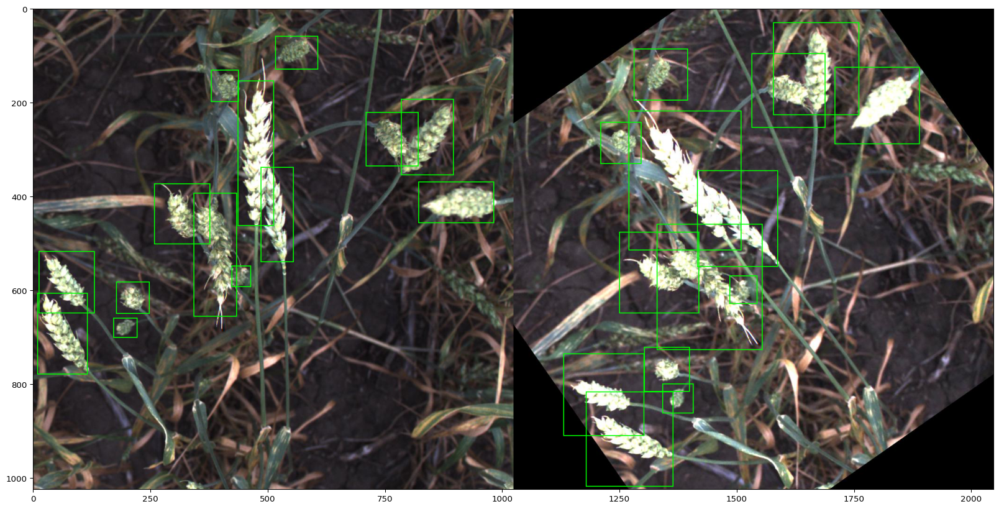

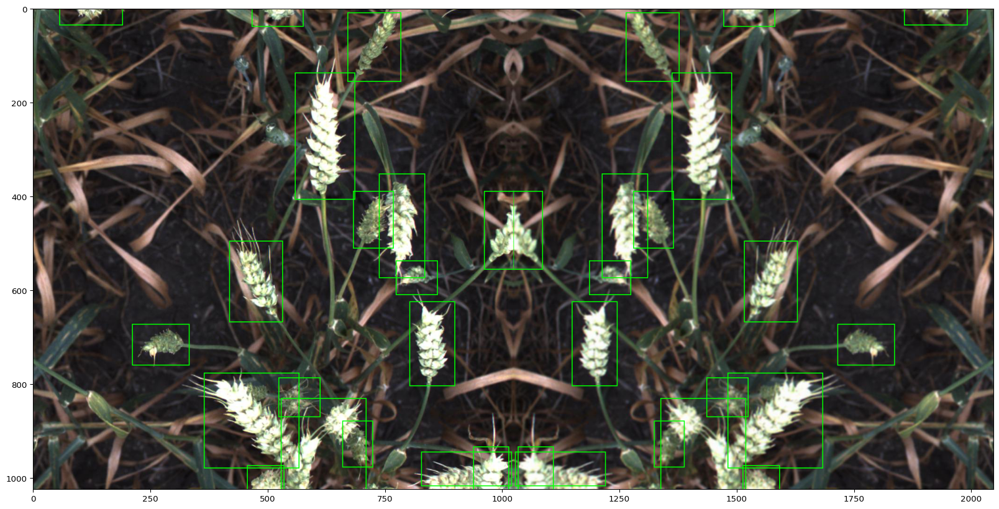

In [ ]:
grouped_train = train_filtred.groupby(['image_id'])
grouped_augmented = augmented_images_df.groupby(['image_id'])

for filename in train_filtred['image_id'].unique()[89:91]:

    group_r_df = grouped_train.get_group(filename)
    group_r_df = group_r_df.reset_index()
    group_r_df = group_r_df.drop(['index'], axis=1)
    bb_r_array = group_r_df.drop(['image_id', 'width', 'height', 'label'], axis=1).values
    train_img = imageio.imread(train_images+filename+".jpg")
    bbs_r = BoundingBoxesOnImage.from_xyxy_array(bb_r_array, shape=train_img.shape)

    group_a_df = grouped_augmented.get_group('aug1_'+filename)
    group_a_df = group_a_df.reset_index()
    group_a_df = group_a_df.drop(['index'], axis=1)
    bb_a_array = group_a_df.drop(['image_id', 'width', 'height', 'label'], axis=1).values
    augmented_img = imageio.imread(train_images+'aug1_'+filename+".jpg")
    bbs_a = BoundingBoxesOnImage.from_xyxy_array(bb_a_array, shape=augmented_img.shape)

    ia.imshow(np.hstack([
            bbs_r.draw_on_image(train_img, size=2),
            bbs_a.draw_on_image(augmented_img, size=2)
            ]))

as we can see from the examples the argumentation was sucessful (left side original, rigth side argumented)